In [28]:
# pylint: disable=no-member

import os
from glob import glob
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from thresholding.otsu_thresholding import otsu_thresholding
from thresholding.adaptative_thresholding import adaptative_thresholding
from thresholding.simple_thresholding import simple_thresholding
from dice import dice

In [ ]:
input_images = "../images/healthy"         
gt_masks = "../masks/healthy"


results = [] # armazena um dicionãrio por imagem

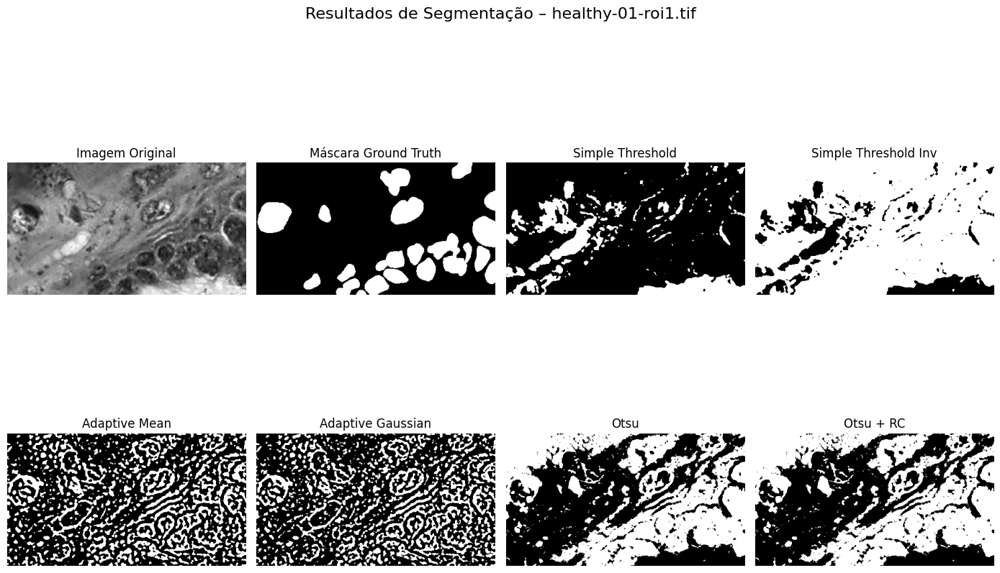

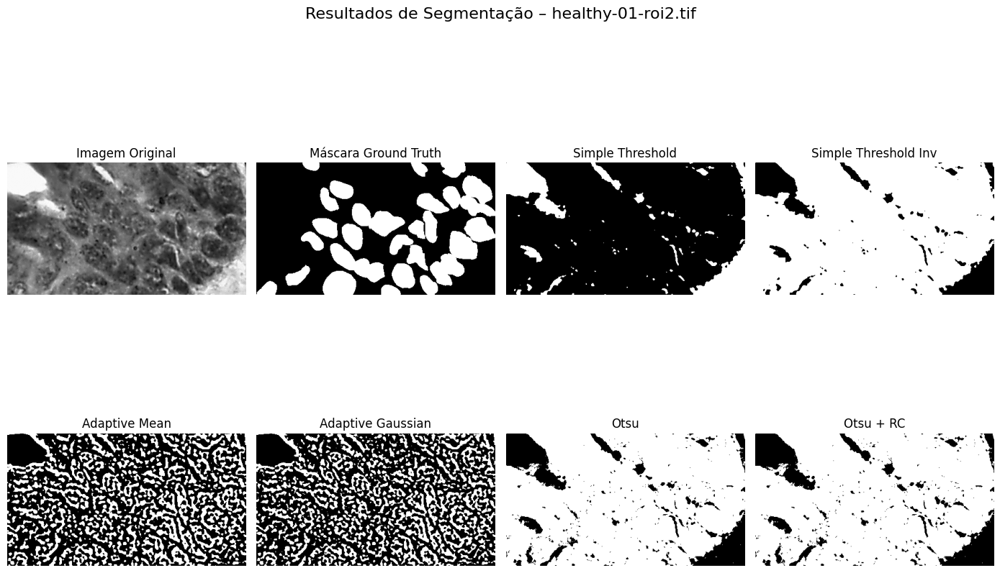

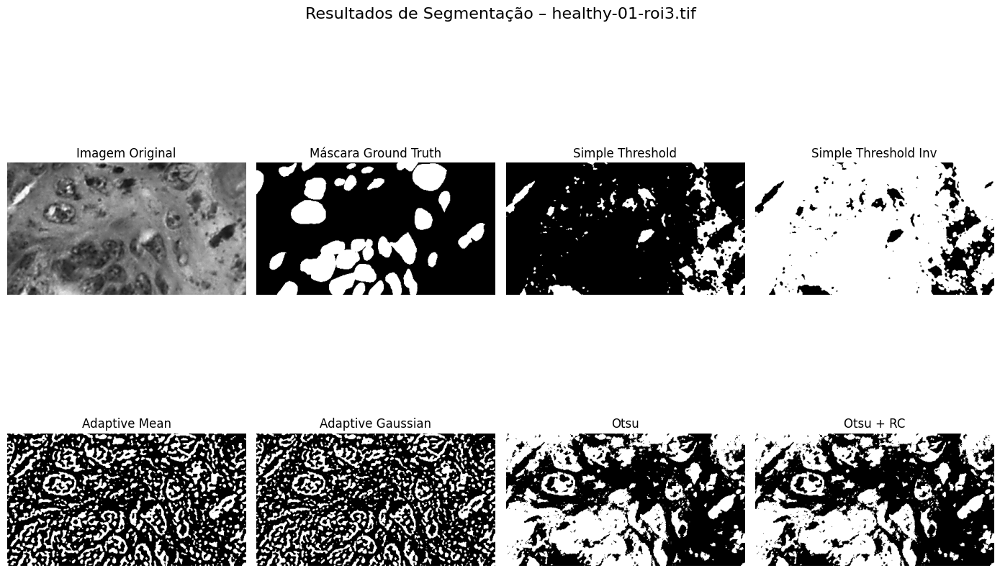

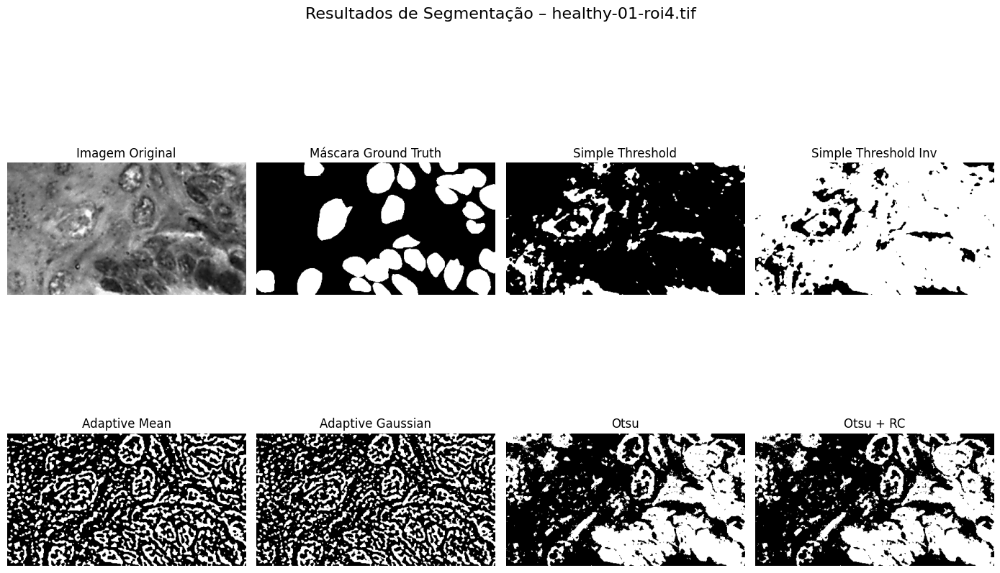

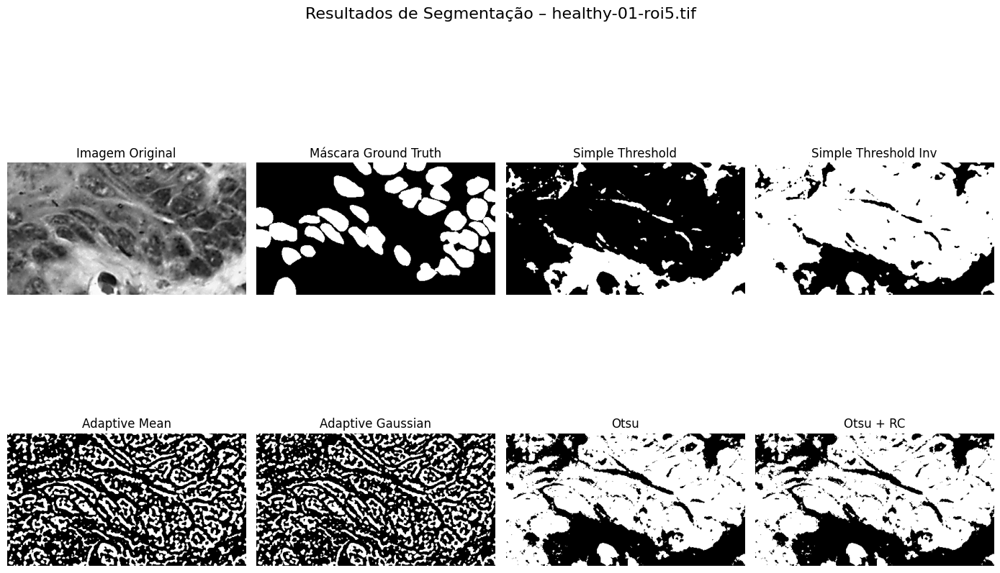

...

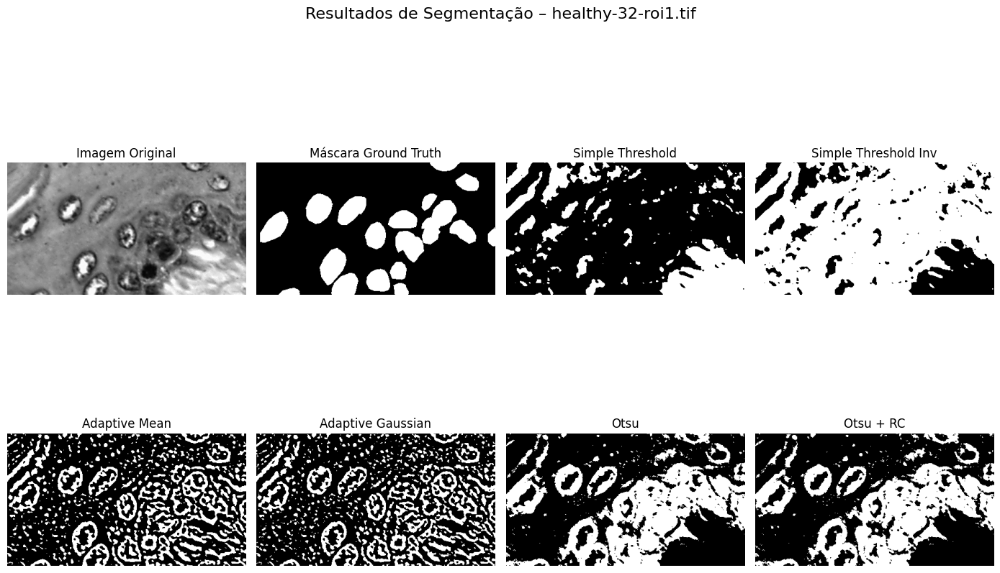

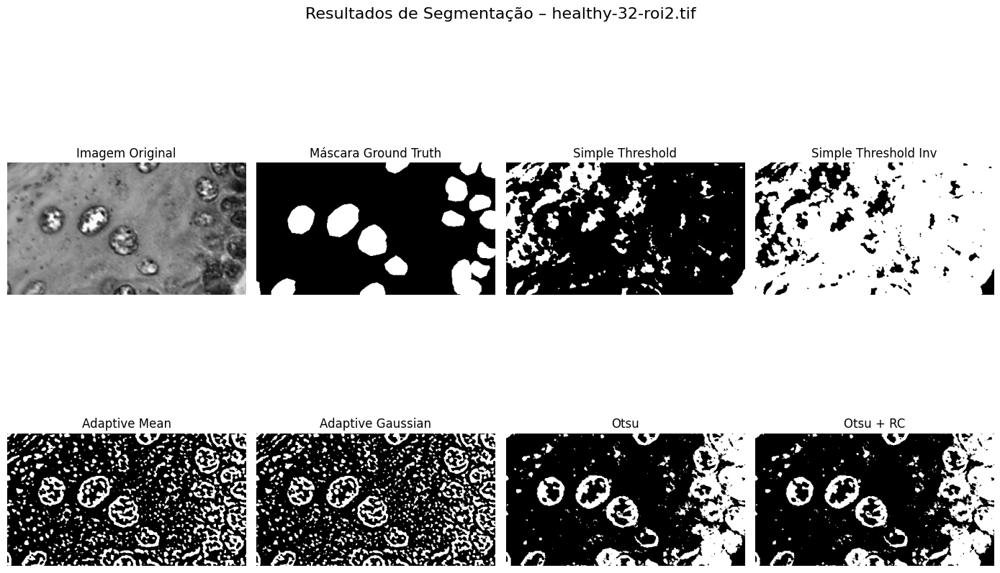

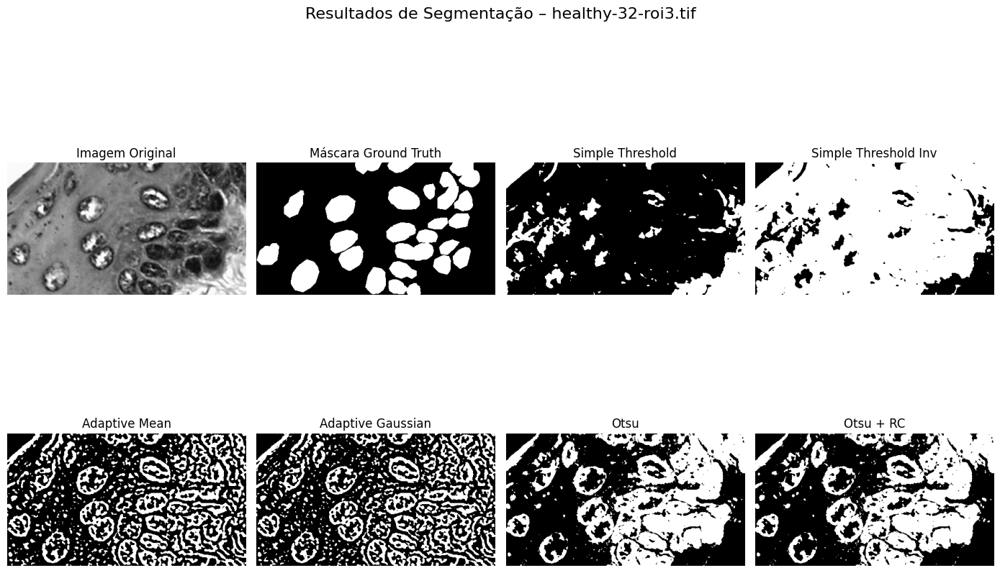

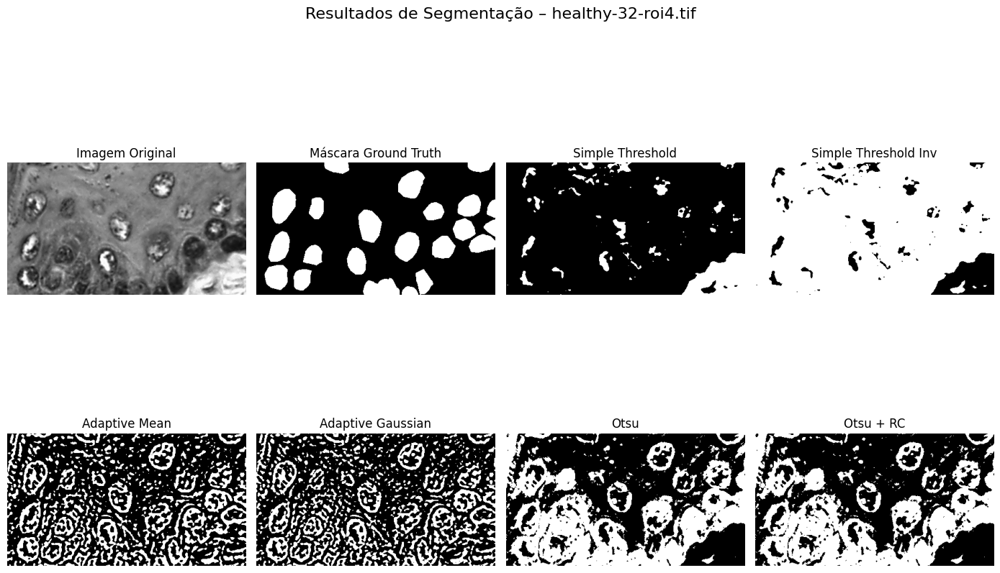

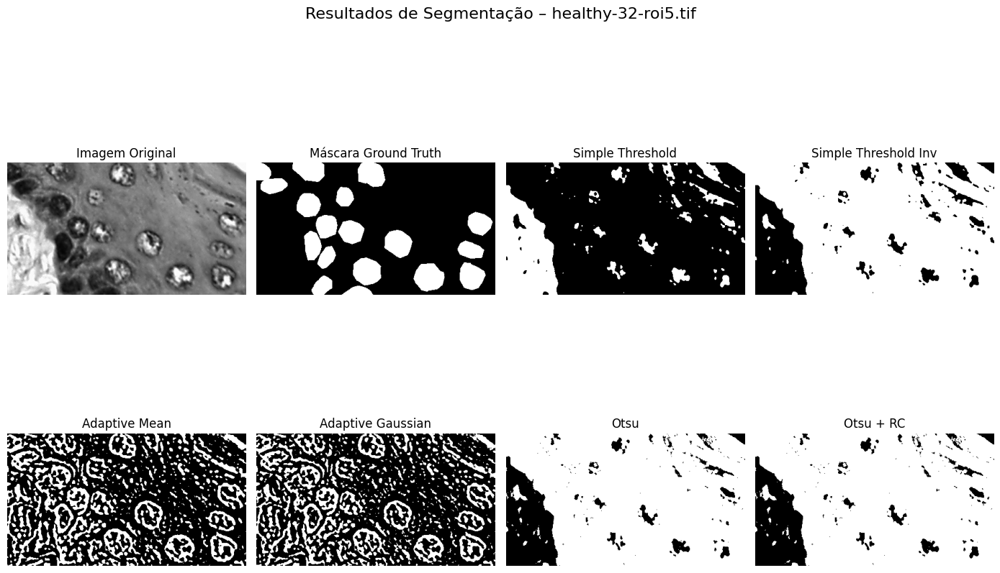

In [ ]:
for img_path in sorted(glob(os.path.join(input_images, "*.tif"))):

    name = os.path.basename(img_path)
    base = os.path.splitext(name)[0] # remove .tif 
    gt_path = os.path.join(gt_masks, base + ".png") # e coloca .png

    gt = cv2.imread(gt_path, 0)

    img = cv2.imread(img_path, 0)

    # simple_thresholding
    th, th_inv, _ = simple_thresholding(img_path)
    dice_th = dice(th, gt)
    dice_th_inv = dice(th_inv, gt)

    # adaptative_thresholding
    ad_mean, ad_gauss = adaptative_thresholding(img_path)
    dice_ad_mean = dice(ad_mean, gt)
    dice_ad_gauss = dice(ad_gauss, gt)

    # otsu
    otsu, rc = otsu_thresholding(img_path)
    dice_otsu = dice(otsu, gt)
    dice_rc = dice(rc, gt)

    results.append({
        "image_name": name,
        "dice_simple": dice_th,
        "dice_simple_inv": dice_th_inv,
        "dice_adapt_mean": dice_ad_mean,
        "dice_adapt_gauss": dice_ad_gauss,
        "dice_otsu": dice_otsu,
        "dice_rc": dice_rc
    })

    plt.figure(figsize=(14, 10))
    plt.suptitle(f"Resultados de Segmentação – {name}", fontsize=16)

    images = [
        (img, "Imagem Original"),
        (gt, "Máscara Ground Truth"),
        (th, "Simple Threshold"),
        (th_inv, "Simple Threshold Inv"),
        (ad_mean, "Adaptive Mean"),
        (ad_gauss, "Adaptive Gaussian"),
        (otsu, "Otsu"),
        (rc, "Otsu + RC"),
    ]

    for i, (im, title) in enumerate(images, 1):
        plt.subplot(2, 4, i)
        plt.imshow(im, cmap='gray')
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

In [31]:
df = pd.DataFrame(results)
df.to_csv("resultados_dice.csv", index=False)

print("\nMÉDIA DOS DICES:")
print("Simple:", df["dice_simple"].mean())
print("Simple Inv:", df["dice_simple_inv"].mean())
print("Adapt Mean:", df["dice_adapt_mean"].mean())
print("Adapt Gauss:", df["dice_adapt_gauss"].mean())
print("Otsu:", df["dice_otsu"].mean())
print("RC:", df["dice_rc"].mean())



MÉDIA DOS DICES:
Simple: 0.10841094466383719
Simple Inv: 0.45366981418866287
Adapt Mean: 0.45958961856441155
Adapt Gauss: 0.4535853941708588
Otsu: 0.5570206738490595
RC: 0.5651740046895957
